In [1]:
import numpy as np
import math
import matplotlib.pylab as plt
import astropy.io.fits as fits
import os
import pandas as pd
%matplotlib inline

In [2]:
pwd

'/Users/waritwij/Documents/GitHub/Przybylski_Star_v1'

In [3]:
dir

<function dir>

In [4]:
filepath = "/Users/waritwij/Documents/GitHub/Przybylski_Star_v1/UROP/"

In [5]:
ls /Users/waritwij/Downloads/UROP

ls: /Users/waritwij/Downloads/UROP: No such file or directory


In [6]:
print(filepath)

/Users/waritwij/Documents/GitHub/Przybylski_Star_v1/UROP/


In [7]:
ls filepath

ls: filepath: No such file or directory


In [8]:
filelist = os.listdir(filepath)
print(filelist)

['HARPS.2005-04-04T04:30:17.582_e2ds_A.fits', 'HARPS.2005-04-04T04:30:17.582_s1d_A.fits', 'HARPS.2005-04-04T04:30:17.582_ccf_G2_A.fits', 'HARPS.2005-04-04T04:30:17.582_bis_G2_A.fits', 'HARPS.2005-04-04T04:30:17.582_s1d_B.fits', 'HARPS.2005-04-04T04:30:17.582_e2ds_B.fits']


In [9]:
filelist[1]
print()

In [10]:
hdul = fits.open(filepath + filelist[1])

In [11]:
hdul.info()

Filename: /Users/waritwij/Documents/GitHub/Przybylski_Star_v1/UROP/HARPS.2005-04-04T04:30:17.582_s1d_A.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU    3011   (313131,)   float32   


In [12]:
spectArrA = hdul[0].data
print(spectArrA)

[ 227.37553  223.99872  230.80449 ... 6087.497   6142.3003  6048.915  ]


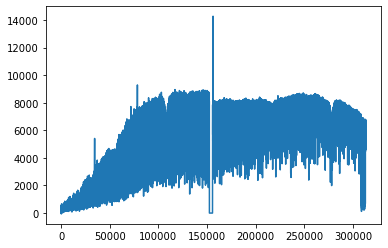

In [13]:
plt.plot(spectArrA)
#plt.xlim(200000,250000)

In [14]:
ls /Users/waritwij/Downloads/UROP/

ls: /Users/waritwij/Downloads/UROP/: No such file or directory


In [15]:
print(filelist)

['HARPS.2005-04-04T04:30:17.582_e2ds_A.fits', 'HARPS.2005-04-04T04:30:17.582_s1d_A.fits', 'HARPS.2005-04-04T04:30:17.582_ccf_G2_A.fits', 'HARPS.2005-04-04T04:30:17.582_bis_G2_A.fits', 'HARPS.2005-04-04T04:30:17.582_s1d_B.fits', 'HARPS.2005-04-04T04:30:17.582_e2ds_B.fits']


In [16]:
for file in filelist:
    if 's1d' in file:
        print(file)

HARPS.2005-04-04T04:30:17.582_s1d_A.fits
HARPS.2005-04-04T04:30:17.582_s1d_B.fits


In [17]:
#hdul = fits.open(filepath + "HARPS.2005-04-04T04:30:17.582_s1d_B.fits")

In [18]:
#hdul.info()

In [19]:
#spectArrB = hdul[0].data

In [20]:
#plt.plot(spectArrB)

In [21]:
hdul[0].header

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / number of bits per data pixel                  
NAXIS   =                    1 / number of data axes                            
NAXIS1  =               313131 / length of data axis 1                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
CRPIX1  =                   1. / Reference pixel                                
CRVAL1  =              3781.61 / Coordinate at reference pixel                  
CDELT1  =                 0.01 / Coordinate increment par pixel                 
CTYPE1  = 'Angstrom'           / Units of coordinate                            
BUNIT   = 'Relative Flux'      / Units of data values                           
ORIGIN  = 'TEST    '        

In [22]:
len(hdul[0].data)

313131

In [23]:
min = hdul[0].header["CRVAL1"]
min

3781.61

In [24]:
max = hdul[0].header["CRVAL1"]+len(hdul[0].data)*hdul[0].header["CDELT1"]
max

6912.92

In [25]:
wavelength = np.arange(len(hdul[0].data))*hdul[0].header["CDELT1"]+hdul[0].header["CRVAL1"]

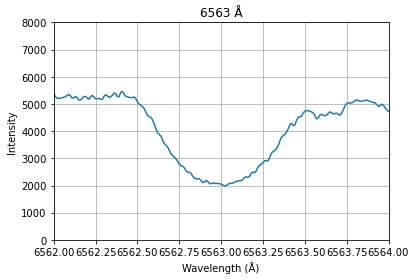

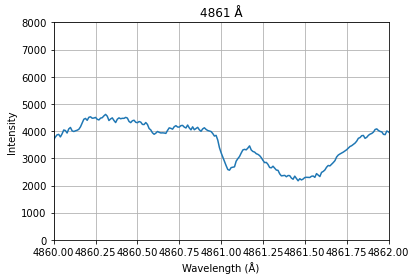

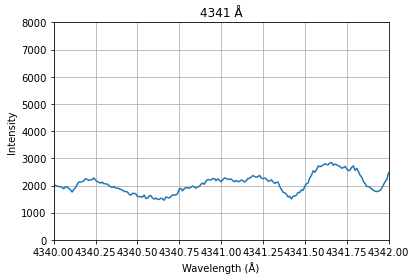

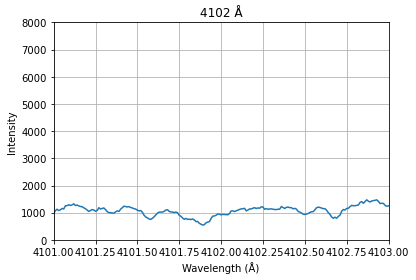

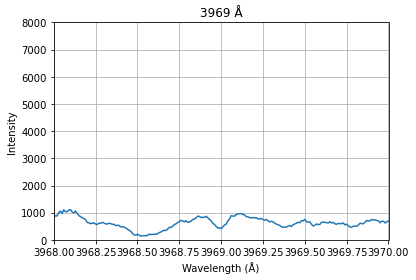

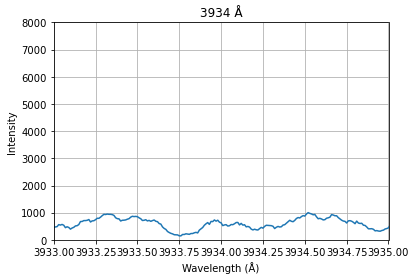

In [26]:
sampWav = [6563, 4861, 4341, 4102, 3969, 3934]

for i in sampWav:
    plt.plot(wavelength, spectArrA)
    plt.grid(True)
    plt.xlim(i-1, i+1)
    plt.ylim(0, 8000)
    plt.title(str(i)+" Å")
    plt.xlabel('Wavelength (Å)')
    plt.ylabel('Intensity')
    plt.show()

In [27]:
def plotWavelength(wavelength, spectralArr, specLambda, lambdaRange):
    plt.plot(wavelength, spectralArr)
    plt.grid(True)
    plt.xlim(specLambda-lambdaRange/2, specLambda+lambdaRange/2)
    plt.title(str(specLambda)+" Å")
    plt.xlabel('Wavelength (Å)')
    plt.ylabel('Intensity')
    plt.vlines(specLambda, ymin = 0, ymax = 14000)
    plt.show()

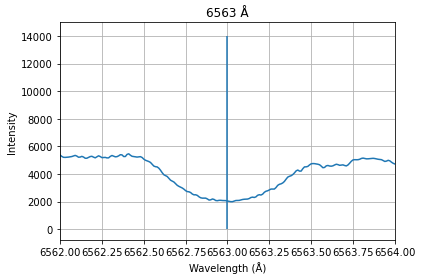

In [28]:
plotWavelength(wavelength, spectArrA, 6563, 2)

In [29]:
data = pd.read_csv("H_lines.csv")
data

,obs_wl_vac(A),unc_obs_wl,ritz_wl_vac(A),unc_ritz_wl,intens,Aki(s^-1),Acc,Ei(cm-1),Ek(cm-1),conf_i,term_i,J_i,conf_k,term_k,J_k,Type,tp_ref,line_ref,Unnamed: 18
0,NaN,NaN,9.123237e+02,8.000000e-06,NaN,122.58,AAA,0.0000000000,[109610.2232],1s,2S,1/2,40,NaN,NaN,NaN,T8637,NaN,NaN
1,NaN,NaN,9.123533e+02,8.000000e-06,NaN,139.13,AAA,0.0000000000,[109606.6628],1s,2S,1/2,39,NaN,NaN,NaN,T8637,NaN,NaN
2,NaN,NaN,9.123853e+02,8.000000e-06,NaN,158.43,AAA,0.0000000000,[109602.8177],1s,2S,1/2,38,NaN,NaN,NaN,T8637,NaN,NaN
3,NaN,NaN,9.124199e+02,8.000000e-06,NaN,181.03,AAA,0.0000000000,[109598.6566],1s,2S,1/2,37,NaN,NaN,NaN,T8637,NaN,NaN
4,NaN,NaN,9.124575e+02,8.000000e-06,NaN,207.62,AAA,0.0000000000,[109594.1439],1s,2S,1/2,36,NaN,NaN,NaN,T8637,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
563,2.559000e+11,3.000000e+08,2.564000e+11,3.000000e+08,NaN,NaN,NaN,[108324.72016],[108324.72055],9p,2P*,1/2,9s,2S,1/2,NaN,NaN,L15291c33,NaN
564,3.510000e+11,5.000000e+08,3.448000e+11,5.000000e+08,NaN,NaN,NaN,[108581.99051],[108581.99080],10p,2P*,1/2,10s,2S,1/2,NaN,NaN,L15291c33,NaN
565,4.671000e+11,7.000000e+08,4.545000e+11,6.000000e+08,NaN,NaN,NaN,[108772.34135],[108772.34157],11p,2P*,1/2,11s,2S,1/2,NaN,NaN,L15291c33,NaN
566,5.500000e+11,9.000000e+10,5.600000e+11,6.000000e+10,NaN,NaN,NaN,97492.319433,97492.319611,3d,2D,3/2,3p,2P*,3/2,NaN,NaN,L4386,NaN


In [30]:
def doppler(lambda_0, v_r):
    lambda_1 = lambda_0*(1+v_r/(3E5))
    return lambda_1

In [31]:
ritz_wl_vac = np.array(data["ritz_wl_vac(A)"])
print(ritz_wl_vac)

[9.12323660e+02 9.12353295e+02 9.12385303e+02 9.12419943e+02
 9.12457513e+02 9.12498352e+02 9.12542852e+02 9.12591463e+02
 9.12644709e+02 9.12703197e+02 9.12767639e+02 9.12838873e+02
 9.12917887e+02 9.13005859e+02 9.13104195e+02 9.13214592e+02
 9.13339105e+02 9.13480251e+02 9.13641133e+02 9.13825609e+02
 9.14038537e+02 9.14286086e+02 9.14576201e+02 9.14919242e+02
 9.15328932e+02 9.15823751e+02 9.16429076e+02 9.17180514e+02
 9.18129300e+02 9.18129317e+02 9.18129305e+02 9.18129319e+02
 9.19351334e+02 9.19351342e+02 9.19351361e+02 9.19351336e+02
 9.19351359e+02 9.20963006e+02 9.20963037e+02 9.20963014e+02
 9.20963039e+02 9.23150275e+02 9.23150274e+02 9.23150316e+02
 9.23150285e+02 9.23150319e+02 9.26225665e+02 9.26225621e+02
 9.26225670e+02 9.26225605e+02 9.30748150e+02 9.30748242e+02
 9.30748175e+02 9.30748249e+02 9.30748142e+02 9.37803361e+02
 9.37803480e+02 9.37803469e+02 9.37803310e+02 9.49742909e+02
 9.49742870e+02 9.49743121e+02 9.49742840e+02 9.49743100e+02
 9.72536500e+02 9.725369

In [32]:
ritz_wl_vac_dopplerCorrected = []
for wavlen in ritz_wl_vac:
    ritz_wl_vac_dopplerCorrected.append(doppler(wavlen, 12.4))
print(ritz_wl_vac_dopplerCorrected)

[912.3613693779467, 912.39100560286, 912.4230149258574, 912.4576563576439, 912.4952279105373, 912.5360685985493, 912.5805704378827, 912.6291834471373, 912.6824316479721, 912.7409220654761, 912.8053667290787, 912.8766036734173, 912.9556209393293, 913.0435965755054, 913.14193664006, 913.252338203136, 913.3768563496734, 913.5180081837079, 913.6788968334973, 913.8633804585053, 914.0763172595293, 914.3238764915546, 914.6140034829747, 914.9570586620027, 915.366765595856, 915.8616050483747, 916.4669550684747, 917.218424127912, 918.1672493443999, 918.1672668451233, 918.1672539445901, 918.167268145177, 919.3893338551386, 919.3893417554651, 919.3893603562341, 919.3893356252119, 919.3893584561555, 921.0010724709147, 921.0011033721919, 921.001080971266, 921.0011058722952, 923.1884318780333, 923.1884306279817, 923.1884727797238, 923.1884418784467, 923.1884761798644, 926.2639492851654, 926.2639050093353, 926.2639540573626, 926.2638889916733, 930.7866214035532, 930.7867127273277, 930.7866460245708, 9

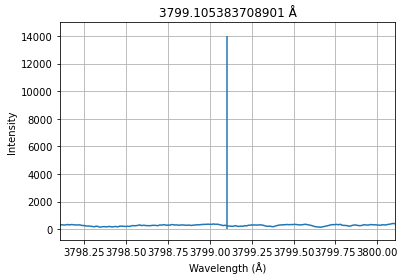

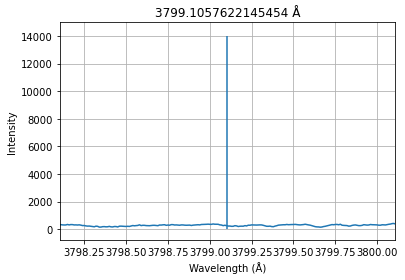

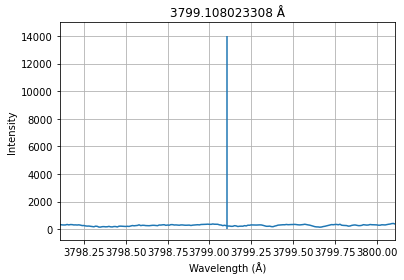

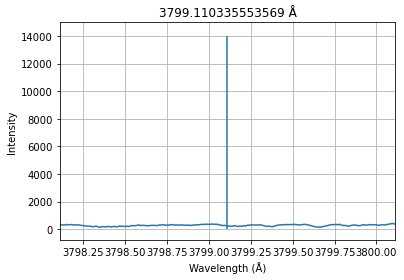

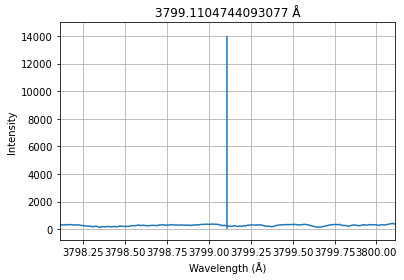

...

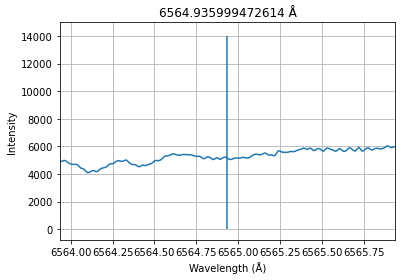

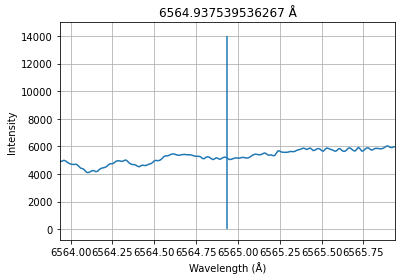

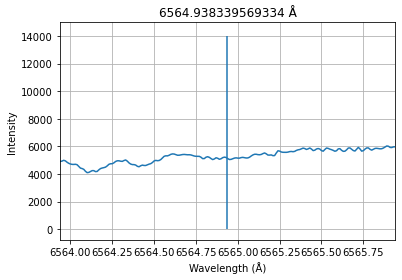

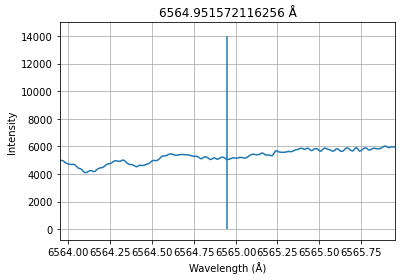

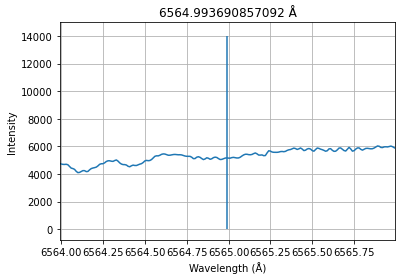

104

In [33]:
count = 0
for doppWL in ritz_wl_vac_dopplerCorrected:
    if doppWL >= min and doppWL <= max:
            plotWavelength(wavelength, spectArrA, doppWL, 2)
            count += 1
count

In [34]:
data2 = pd.read_csv("O_lines.csv")
data2

,element,sp_num,obs_wl_vac(A),ritz_wl_vac(A),intens,Aki(s^-1),Acc,Ei(cm-1),Ek(cm-1),conf_i,term_i,J_i,conf_k,term_k,J_k,Type,tp_ref,line_ref,Unnamed: 18
0,O,8,NaN,1.463430e+01,NaN,8.085000e+10,AA,0.0,(6833270.2344),1s,2S,1/2,6p,2P*,3/2,NaN,T6492extrap,NaN,NaN
1,O,8,NaN,1.463440e+01,NaN,8.085000e+10,AA,0.0,(6833214.5940),1s,2S,1/2,6p,2P*,1/2,NaN,T6492extrap,NaN,NaN
2,O,8,NaN,1.482050e+01,NaN,1.409000e+11,AA,0.0,(6747408.7880),1s,2S,1/2,5p,2P*,3/2,NaN,T6492extrap,NaN,NaN
3,O,8,NaN,1.482070e+01,NaN,1.409000e+11,AA,0.0,(6747312.6360),1s,2S,1/2,5p,2P*,1/2,NaN,T6492extrap,NaN,NaN
4,O,8,NaN,1.517600e+01,NaN,2.794000e+11,AA,0.0,(6589342.716),1s,2S,1/2,4p,2P*,3/2,NaN,T6492extrap,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5908,O,1,NaN,1.670732e+06,NaN,3.920000e+01,C+,102908.489,102968.343,2s2.2p3.(4S*).4d,3D*,1,2s2.2p3.(4S*).4f,3F,2,NaN,T5713LS,NaN,NaN
5909,O,2,NaN,4.995000e+06,NaN,1.300000e-07,B+,26810.55,26830.57,2s2.2p3,2D*,5/2,2s2.2p3,2D*,3/2,M1,T247,L11267,NaN
5910,O,2,NaN,4.995005e+06,NaN,1.490000e-20,E,26810.55,26830.57,2s2.2p3,2D*,5/2,2s2.2p3,2D*,3/2,E2,"T5047,T4644",NaN,NaN
5911,O,2,NaN,5.025000e+07,NaN,4.240000e-24,E,40468.01,40470.00,2s2.2p3,2P*,3/2,2s2.2p3,2P*,1/2,E2,"T5047,T4644",NaN,NaN


In [35]:
o_wl_vac = np.array(data2["ritz_wl_vac(A)"])
print(o_wl_vac)
len(o_wl_vac)

[1.463430e+01 1.463440e+01 1.482050e+01 ... 4.995005e+06 5.025000e+07
 5.030000e+07]


5913

In [36]:
o_lines_dopplerCorrected = []
for wl in o_wl_vac:
    o_lines_dopplerCorrected.append(doppler(wl, 12.4))
print(o_lines_dopplerCorrected)

[14.6349048844, 14.635004888533333, 14.821112580666666, 14.821312588933333, 15.176627274666666, 15.177127295333333, 16.00616156066667, 16.007361610266667, 17.805935948266665, 18.627769916, 18.638470358266666, 18.731474202266664, 18.967883973466666, 18.97328419666667, 21.602892882666666, 21.805301248533336, 21.807901356, 22.102113516266666, 64.003145354, 64.0052454408, 64.00614547800001, 64.00844557306667, 64.06394786706667, 64.06474790013334, 64.06684798693334, 67.72469917186667, 67.7280993124, 67.72889934546667, 67.73249949426666, 67.79220196186667, 67.79370202386666, 67.79790219746667, 75.8434347324, 75.847634906, 75.853635154, 75.8584353524, 75.92633815893333, 75.92993830773334, 75.94023873346667, 78.86515962520001, 78.86885977813334, 78.86885977813334, 78.90306119173333, 78.90306119173333, 78.90306119173333, 81.47306741426667, 81.47706757959999, 81.47706757959999, 81.51356908826666, 81.51356908826666, 81.51356908826666, 81.59807258093333, 84.42878957906666, 86.0783577584, 86.081357

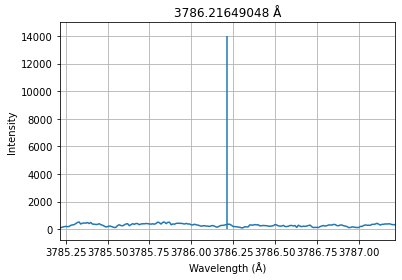

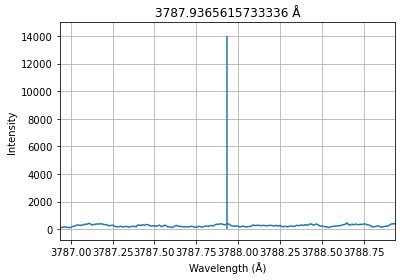

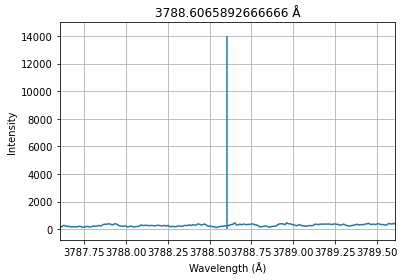

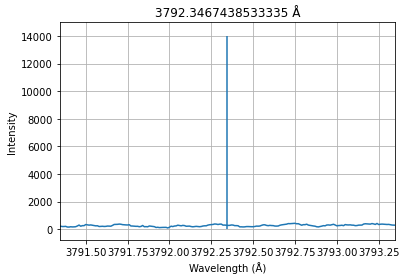

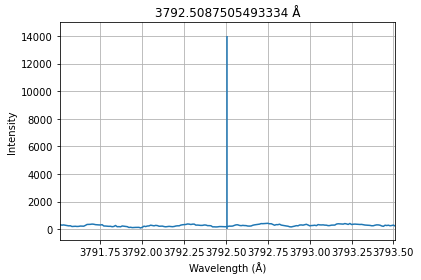

...

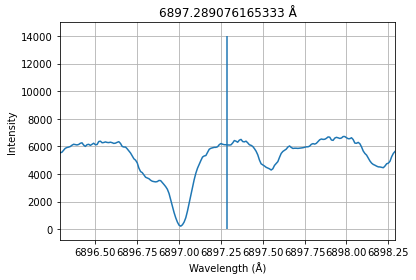

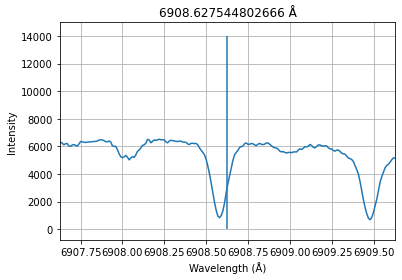

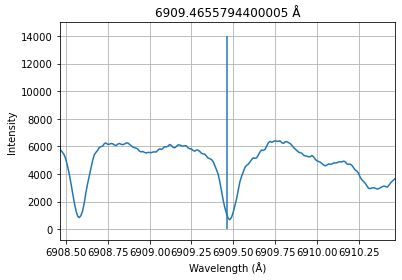

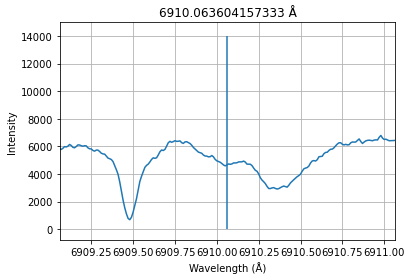

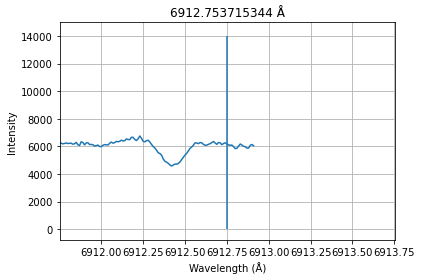

920

In [37]:
count1 = 0
for doppWL in o_lines_dopplerCorrected:
    if doppWL >= min and doppWL <= max:
            plotWavelength(wavelength, spectArrA, doppWL, 2)
            count1 += 1
count1